<a href="https://colab.research.google.com/github/PiyushBagde/yolov8m_custom_model/blob/main/yolov8m_object_detection_on_custom_dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!nvidia-smi

Sat Jul 20 09:21:45 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   50C    P8               9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [6]:
import os
HOME = os.getcwd()
print(HOME)

/content


In [7]:

!pip install ultralytics

from IPython import display
display.clear_output()

import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.2.60 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 30.2/78.2 GB disk)


In [8]:
from ultralytics import YOLO

from IPython.display import display, Image

## Custom Training

In [9]:
!mkdir {HOME}/datasets
%cd {HOME}/datasets

!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="GWDEPbY8Y4cZYHngidWM")
project = rf.workspace("solarpanel-3ku0x").project("solar_panel-cvecl")
version = project.version(3)
dataset = version.download("yolov8")


/content/datasets
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.7/76.7 kB 2.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 7.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 7.9 MB/s eta 0:00:00
  Attempting uninstall: chardet
    Found existing installation: chardet 5.2.0
    Uninstalling chardet-5.2.0:
      Successfully uninstalled chardet-5.2.0


loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics==8.0.196 is required but found version=8.2.60, to fix: `pip install ultralytics==8.0.196`



Extracting Dataset Version Zip to Solar_Panel-3 in yolov8:: 100%|██████████| 15670/15670 [00:04<00:00, 3420.43it/s]


In [ ]:
#@title Select YOLOv8 🚀 logger {run: 'auto'}
logger = 'Comet' #@param ['Comet', 'TensorBoard']

if logger == 'Comet':
  %pip install -q comet_ml
  import comet_ml; comet_ml.init()
elif logger == 'TensorBoard':
  %load_ext tensorboard
  %tensorboard --logdir .

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.5/679.5 kB 14.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/3.3 MB 62.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 301.8/301.8 kB 37.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 137.9/137.9 kB 13.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 979.1/979.1 kB 48.6 MB/s eta 0:00:00


COMET WARNING: comet_ml.init() is deprecated and will be removed soon. Please use comet_ml.login()


Please paste your Comet API key from https://www.comet.com/api/my/settings/
(api key may not show as you type)
Comet API key: ··········


COMET INFO: Valid Comet API Key saved in /root/.comet.config (set COMET_CONFIG to change where it is saved).


In [ ]:
%pip install -q clearml
import clearml
clearml.browser_login()

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 10.2 MB/s eta 0:00:00


<IPython.core.display.Javascript object>

ClearML automatic browser login failed, please login or create a new account
To get started with ClearML: setup your own `clearml-server`, or create a free account at https://app.clear.ml

Please login to https://app.clear.ml , then press [Enter] to connect 


<IPython.core.display.Javascript object>


We cannot connect automatically (adblocker / incognito?) 😟 
Please go to https://app.clear.ml/settings/workspace-configuration 
Then press  + Create new credentials  
And copy/paste your Access Key here: ZHK2W6BWANL0RWS02BXGMO9YR0JERZ
 Setting access key 
Now copy/paste your Secret Key here: 0qXXA5h62HuUdhXbLUgvQ3ETBMMdNZECGs_TWB-H8jUGWdJ-p5eYK0ePQroBrldniKQ
 Setting secret key 


Hurrah! 🥳 🎊 🎉
🤖 ClearML connected successfully - let's build something! 🚀


In [10]:
%load_ext tensorboard
%tensorboard --logdir /content/runs/detect/train

<IPython.core.display.Javascript object>

In [ ]:
%reload_ext tensorboard

In [13]:
%cd {HOME}

!yolo task=detect mode=train epochs=40 batch=36 model=yolov8m.yaml data={dataset.location}/data.yaml imgsz=640 plots=True device=0 amp=True

/content
Ultralytics YOLOv8.2.60 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.yaml, data=/content/datasets/Solar_Panel-3/data.yaml, epochs=40, time=None, patience=100, batch=36, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=Tru

In [ ]:
!ls {HOME}/runs/detect/train/

args.yaml					    R_curve.png		 val_batch0_labels.jpg
confusion_matrix_normalized.png			    results.csv		 val_batch0_pred.jpg
confusion_matrix.png				    results.png		 val_batch1_labels.jpg
events.out.tfevents.1720960210.4d44f4feccec.2723.0  train_batch0.jpg	 val_batch1_pred.jpg
F1_curve.png					    train_batch1.jpg	 val_batch2_labels.jpg
labels_correlogram.jpg				    train_batch2.jpg	 val_batch2_pred.jpg
labels.jpg					    train_batch4890.jpg  weights
P_curve.png					    train_batch4891.jpg
PR_curve.png					    train_batch4892.jpg


/content


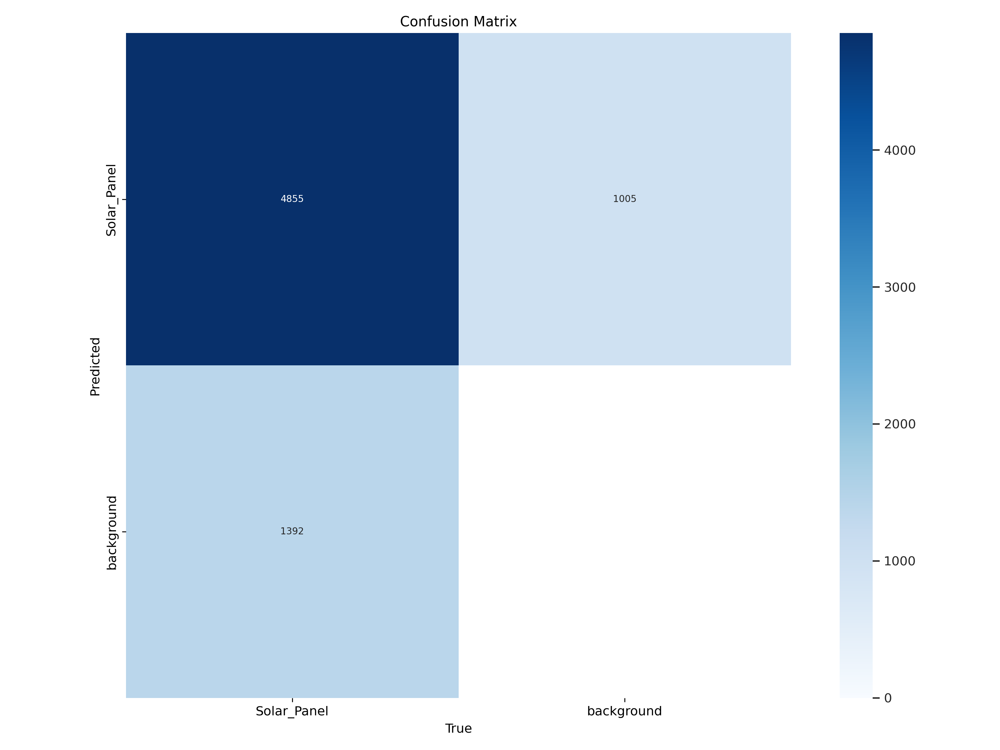

In [ ]:
%cd {HOME}
Image(filename=f'{HOME}/runs/detect/train/confusion_matrix.png', width=600)

/content


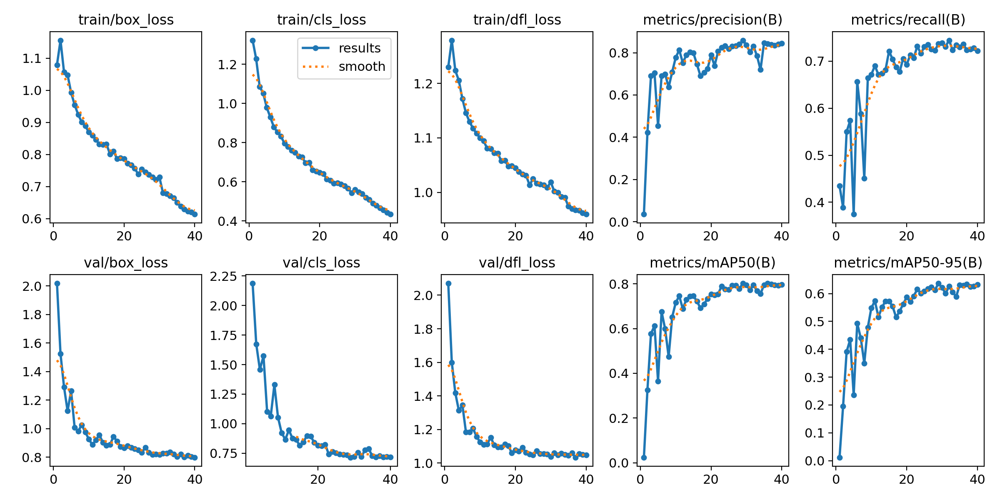

In [ ]:
%cd {HOME}
Image(filename=f'{HOME}/runs/detect/train/results.png', width=600)

/content


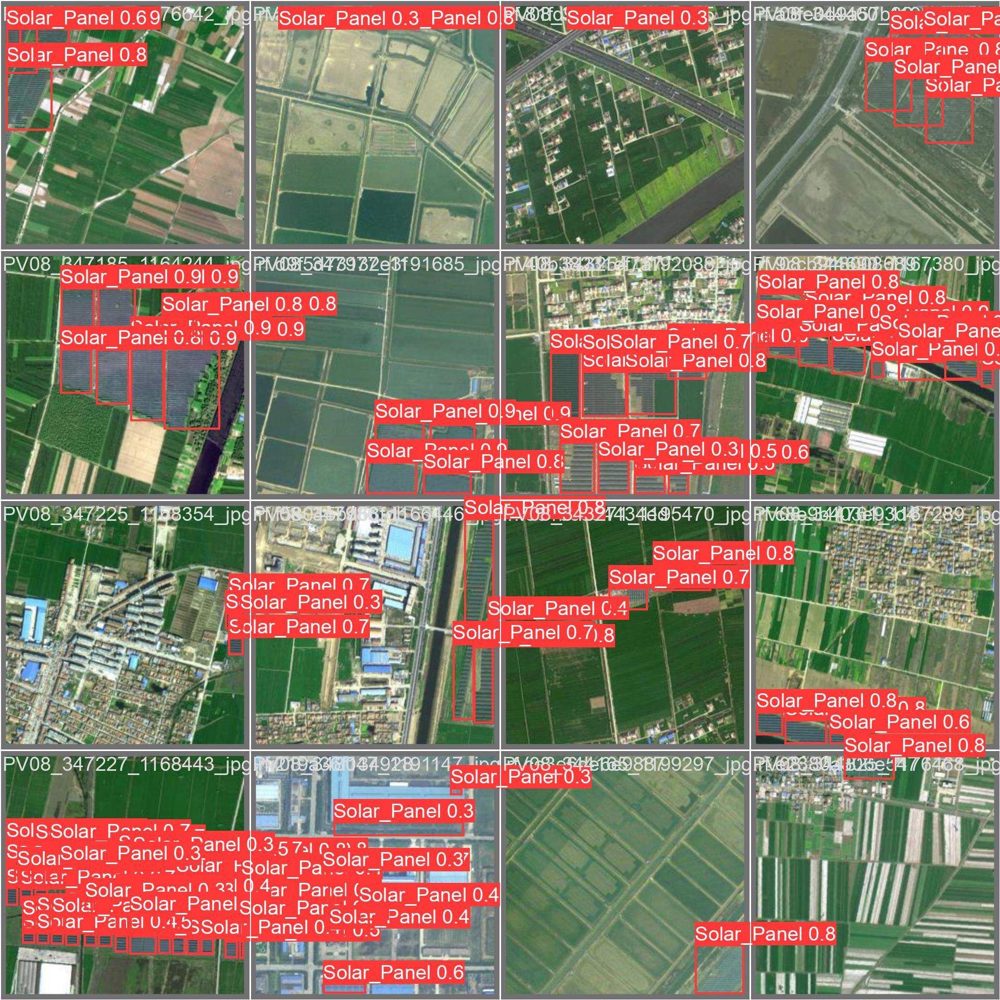

In [ ]:
%cd {HOME}
Image(filename=f'{HOME}/runs/detect/train/val_batch0_pred.jpg', width=600)

## Validate Custom Model

In [ ]:
%cd {HOME}

!yolo task=detect mode=val model={HOME}/runs/detect/train/weights/best.pt data={dataset.location}/data.yaml

/content
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25840339 parameters, 0 gradients, 78.7 GFLOPs
val: Scanning /content/datasets/Solar_Panel-3/valid/labels.cache... 1374 images, 57 backgrounds, 0 corrupt: 100% 1374/1374 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 86/86 [00:38<00:00,  2.24it/s]
                   all       1374       6247       0.86      0.737      0.802      0.637
Speed: 0.4ms preprocess, 19.9ms inference, 0.0ms loss, 1.5ms postprocess per image
Results saved to runs/detect/val
💡 Learn more at https://docs.ultralytics.com/modes/val


In [ ]:
%cd {HOME}
!yolo task=detect mode=predict model={HOME}/runs/detect/train/weights/best.pt conf=0.25 source={dataset.location}/test/images save=True

/content
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25840339 parameters, 0 gradients, 78.7 GFLOPs

WARNING ⚠️ NMS time limit 0.550s exceeded
image 1/610 /content/datasets/Solar_Panel-3/test/images/1048-S-River-Meadows-Dr_Fayetteville_AR-72701_United-States_t58519_jpg.rf.84f52621bbcd3967b663c6f7106d8340.jpg: 640x640 1 Solar_Panel, 37.0ms
image 2/610 /content/datasets/Solar_Panel-3/test/images/1209-S-Gentle-Valley-Dr_Fayetteville_AR-72704_United-States_t2656_jpg.rf.c3cb2c5b59325fc130b503e4de7bed5e.jpg: 640x640 6 Solar_Panels, 37.0ms
image 3/610 /content/datasets/Solar_Panel-3/test/images/2183-E-Wolf-Creek-Dr_Huntingdon_AR-72703_United-States_t43697_jpg.rf.74e7441210c7ea649045de559831e152.jpg: 640x640 2 Solar_Panels, 37.0ms
image 4/610 /content/datasets/Solar_Panel-3/test/images/3090-Birch-Pl_Springdale_AR-72762_United-States_t72090_jpg.rf.a3a31da00c69c255dbcadff3ddd9d827.jpg: 640x640 1 Solar_Panel, 37.0ms
ima

**NOTE:** Let's take a look at few results.

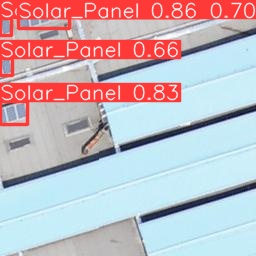

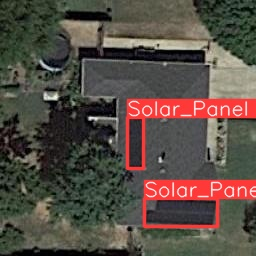

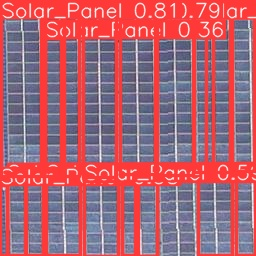

In [ ]:
import glob
from IPython.display import Image, display

for image_path in glob.glob(f'{HOME}/runs/detect/predict/*.jpg')[:3]:
      display(Image(filename=image_path, width=600))
      print("\n")

In [ ]:
!yolo val model=/content/runs/detect/train/weights/best.pt data={dataset.location}/data.yaml imgsz=640 batch=36 conf=0.25 iou=0.6 device=0

Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25840339 parameters, 0 gradients, 78.7 GFLOPs
val: Scanning /content/datasets/Solar_Panel-3/valid/labels.cache... 1374 images, 57 backgrounds, 0 corrupt: 100% 1374/1374 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 39/39 [00:42<00:00,  1.08s/it]
                   all       1374       6247      0.861      0.741      0.825       0.69
Speed: 1.4ms preprocess, 21.9ms inference, 0.0ms loss, 2.0ms postprocess per image
Results saved to runs/detect/val
💡 Learn more at https://docs.ultralytics.com/modes/val


In [ ]:

!zip -r custom_model1.zip /content
!cp custom_model.zip /content/drive/MyDrive


Streaming output truncated to the last 5000 lines.
  adding: content/datasets/Solar_Panel-3/train/images/Washington_County_task15195_jpg.rf.1d68d27d250c1f6762fd45d2cf711b09.jpg (deflated 1%)
  adding: content/datasets/Solar_Panel-3/train/images/Washington_County_task30346_jpg.rf.141f2170f7936cfb3abc7cdbdd4a1352.jpg (deflated 1%)
  adding: content/datasets/Solar_Panel-3/train/images/Franklin_County_task11004_jpg.rf.3c6f878defccfa82f5b6372ee4dd24c8.jpg (deflated 1%)
  adding: content/datasets/Solar_Panel-3/train/images/Baxter_County_task4676_jpg.rf.de3899f41786846fe4bf373ad48d4739.jpg (deflated 1%)
  adding: content/datasets/Solar_Panel-3/train/images/Benton_County_task2865_jpg.rf.23f1b87a6523f6070671249803cd1e7b.jpg (deflated 1%)
  adding: content/datasets/Solar_Panel-3/train/images/PV03_325739_1198770_jpg.rf.53270bd9665e3895e493b9989b728917.jpg (deflated 3%)
  adding: content/datasets/Solar_Panel-3/train/images/Benton_County_task14463_jpg.rf.91eba0cfb90d8c460ca7cccb8caec66e.jpg (deflat

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
!cp /content/drive/MyDrive/best1.pt /content

In [5]:
%pip install ultralytics sahi

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 802.9/802.9 kB 11.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 113.6/113.6 kB 18.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.4/88.4 kB 17.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvi

In [47]:
from sahi import AutoDetectionModel

detection_model = AutoDetectionModel.from_pretrained(
    model_type="yolov8",
    model_path="/content/best1.pt",
    confidence_threshold=0.4,
    device="cuda:0",  # or 'cuda:0'
)

In [52]:
from sahi.predict import get_sliced_prediction

result = get_sliced_prediction(
    "/content/test/test3.jpg",
    detection_model,
    slice_height=256,
    slice_width=256,
    overlap_height_ratio=0.2,
    overlap_width_ratio=0.2,
)

Performing prediction on 60 slices.


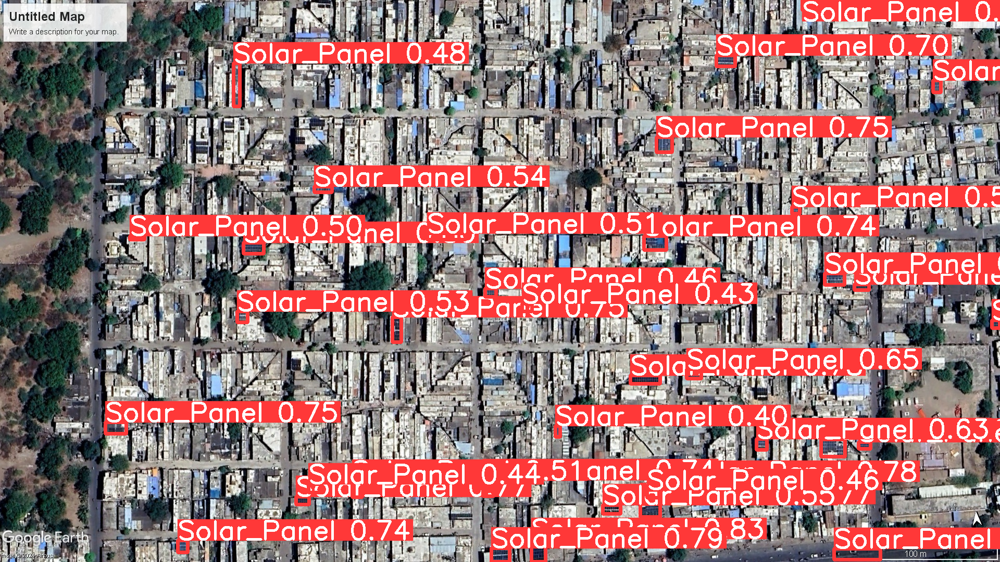

In [53]:
result.export_visuals(export_dir="/content/")
Image("/content/prediction_visual.png")

In [58]:
# Access the object prediction list
object_prediction_list = result.object_prediction_list

# Convert to COCO annotation, COCO prediction, imantics, and fiftyone formats
result.to_coco_annotations()[:3]
result.to_coco_predictions(image_id=1)[:3]
result.to_imantics_annotations()[:3]
result.to_fiftyone_detections()[:3]

[<Detection: {
     'id': '669b9b2af7efb8935ec85808',
     'attributes': {},
     'tags': [],
     'label': 'Solar_Panel',
     'bounding_box': [
         0.5315142234166463,
         0.9583843089916088,
         0.01400552491346995,
         0.04089896590621383,
     ],
     'mask': None,
     'confidence': 0.8281281590461731,
     'index': None,
 }>,
 <Detection: {
     'id': '669b9b2af7efb8935ec85809',
     'attributes': {},
     'tags': [],
     'label': 'Solar_Panel',
     'bounding_box': [
         0.820985984802246,
         0.7819061897419117,
         0.023810895284016927,
         0.031006578162864402,
     ],
     'mask': None,
     'confidence': 0.8277857899665833,
     'index': None,
 }>,
 <Detection: {
     'id': '669b9b2af7efb8935ec8580a',
     'attributes': {},
     'tags': [],
     'label': 'Solar_Panel',
     'bounding_box': [
         0.243351548910141,
         0.4315122922261556,
         0.020685404539108276,
         0.01955322336267542,
     ],
     'mask': None

In [19]:
from sahi.predict import get_prediction

# With an image path
result = get_prediction("/content/test2.jpg", detection_model)


In [28]:
from sahi.predict import get_sliced_prediction

result = get_sliced_prediction(
    "/content/test2.jpg",
    detection_model,
    slice_height=640,
    slice_width=640,
    overlap_height_ratio=0.2,
    overlap_width_ratio=0.2,
)

Performing prediction on 8 slices.


In [33]:
from sahi.predict import predict

result = predict(
    model_type="yolov8",
    model_path="/content/best1.pt",
    model_device="cuda:0",  # or 'cuda:0'
    model_confidence_threshold=0.4,
    source="/content/test",
    slice_height=640,
    slice_width=640,
    overlap_height_ratio=0.2,
    overlap_width_ratio=0.2,
)

There are 2 listed files in folder: test/


Performing inference on images:   0%|          | 0/2 [00:00<?, ?it/s]

Performing prediction on 8 slices.


Performing inference on images:  50%|█████     | 1/2 [00:00<00:00,  1.07it/s]

Prediction time is: 787.53 ms
Performing prediction on 8 slices.


Performing inference on images: 100%|██████████| 2/2 [00:01<00:00,  1.33it/s]

Prediction time is: 402.99 ms
Prediction results are successfully exported to runs/predict/exp4


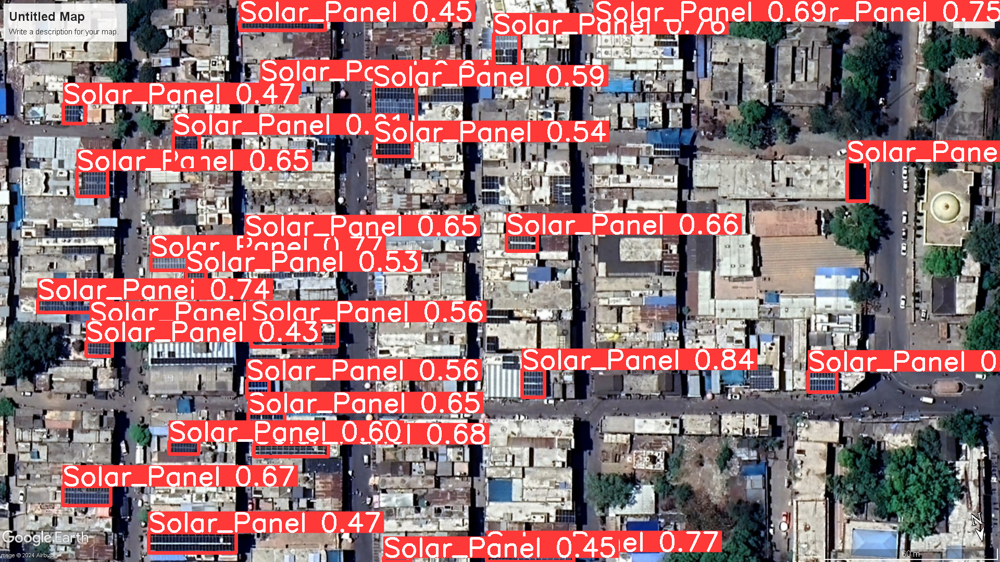

In [44]:
Image("/content/runs/predict/exp4/visuals/test.png")


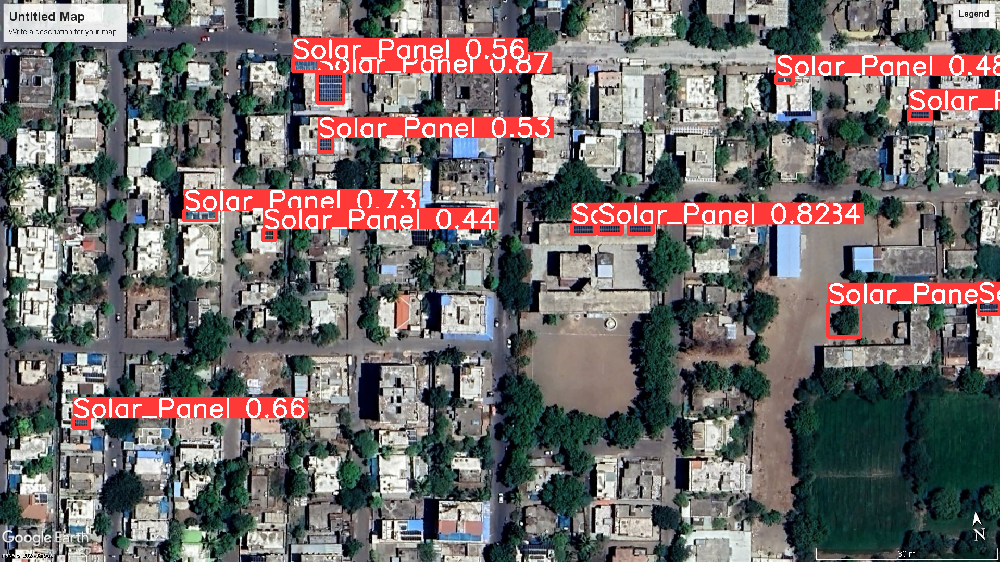

In [45]:
Image("/content/runs/predict/exp4/visuals/test2.png")

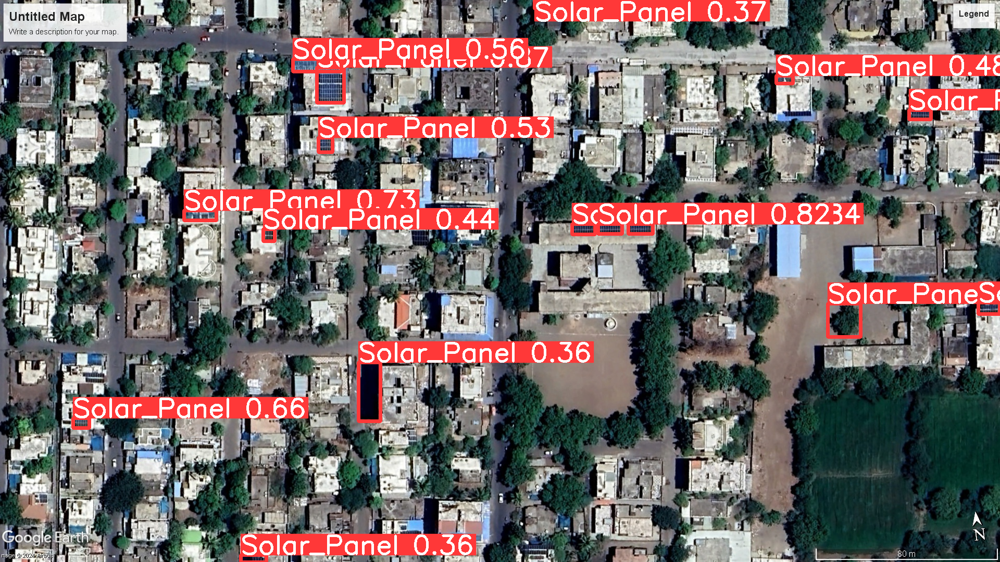

In [25]:
result.export_visuals(export_dir="/content/")
Image("/content/prediction_visual.png")

# Detection



In [ ]:
# copy best1.pt from drive to /content

!cp /content/drive/MyDrive/best1.pt /content

%pip install ultralytics sahi
from sahi import AutoDetectionModel

detection_model = AutoDetectionModel.from_pretrained(
    model_type="yolov8",
    model_path="/content/best1.pt",
    confidence_threshold=0.80,
    device="cuda:0",  # or 'cuda:0'
)


In [ ]:
from sahi.predict import get_sliced_prediction

destination_dir = "/content/drive/MyDrive/Solar/Area/testing"

image_path = f"{destination_dir}/solar_s3.tif.jpg"

result = get_sliced_prediction(
    image_path,
    detection_model,
    slice_height=144,
    slice_width=256,
    overlap_height_ratio=0.2,
    overlap_width_ratio=0.2,
)
no_of_panels = len(result.object_prediction_list)
no_of_panels

In [ ]:
result.export_visuals(export_dir="/content/")
Image("/content/prediction_visual.png")

import os
import shutil

# Assuming the image name is extracted from the path used in get_sliced_prediction
image_name = image_path.split('/')[-1].split('.')[0]

# New file name with the image name
new_filename = f"{image_name}_prediction.png"

# Destination directory in Google Drive
# Adjust the path as needed

# Create the destination directory if it doesn't exist
os.makedirs(destination_dir, exist_ok=True)

# Move and rename the file
source_path = "/content/prediction_visual.png"
destination_path = os.path.join(destination_dir, new_filename)
shutil.move(source_path, destination_path)

print(f"Prediction visualization saved to: {destination_path}")

In [ ]:
# create a csv file which appends above image name and no_of_panels
import csv

# Data to be written
data = [[image_path, no_of_panels]]

# Open the CSV file in append mode
with open('/content/panel_count.csv', 'a', newline='') as file:
    writer = csv.writer(file)
    # Write the data
    writer.writerows(data)

# prompt: delete first line of csv file panel_count.csv

with open('/content/panel_count.csv', 'r') as f:
    lines = f.readlines()
with open('/content/panel_count.csv', 'w') as f:
    f.writelines(lines[1:])

In [ ]:
source_file = '/content/panel_count.csv'

# Destination file path
destination_file = os.path.join(destination_dir, 'panel_count.csv')

# Copy the file
shutil.copy(source_file, destination_file)

print(f"panel_count.csv copied to: {destination_file}")

!rm /content/panel_count.csv